# Project: Investigating factors that affect show up for medical appointment in Brazil using 'No-show-appointments' Dataset 
## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

> **Tip**: In this section of the report, provide a brief introduction to the dataset you've selected for analysis. At the end of this section, describe the questions that you plan on exploring over the course of the report. Try to build your report around the analysis of at least one dependent variable and three independent variables.
>
> If you haven't yet selected and downloaded your data, make sure you do that first before coming back here. If you're not sure what questions to ask right now, then make sure you familiarize yourself with the variables and the dataset context for ideas of what to explore.

## The dataset 
The dataset can be obtained from here:
https://www.kaggle.com/datasets/joniarroba/noshowappointments

The dataset has 110,527 medical appointments with 14 associated fatures giving information on the medical appointments. The patient's show-up or no-show up to the appointment is the target variable. 
* PatientId:- Identification of a patient
* AppointmentID:- Identification of each appointment
* Gender:- Male or Female . Female is the greater proportion, woman takes way more care of they health in comparison to man.
* AppointmentDay:- The day of the actuall appointment, when they have to visit the doctor.
* ScheduleDay:- The day someone called or registered the appointment, this is before appointment of course.
* Age:- How old is the patient.
* Neighbourhood:- Where the appointment takes place, the medical center.
* Scholarship:- True of False . Scholarship offered by Bolsa Familia see here:
https://en.wikipedia.org/wiki/Bolsa_Fam%C3%ADlia
* Hipertension:- True or False (1 or 0)
* Diabetes:-True or False (1 or 0)
* Alcoholism:-True or False (1 or 0)
* Handcap:-True or False (1 or 0)
* SMS_received:- 1 or more messages sent to the patient (1 or 0).
* No-show:- True or False. (No or Yes)

### Posible  Questions to be answered from the analysis:
1. Which gender showed up most for the appointment
2. What days/months/year were the appointments made and what time? Could this affect show up for the appointment.
3. What age showed up most for the appointment?
4. Did neigbourhood affect showing up for the appointment?
5. Did scholarship affect show up?
6. What disease is associateed with high number of show ups?
7. Does receiving sms impact the likelihood of show up?

In [1]:
# Importing all necessary packages
import numpy as np
import pandas as pd
import plotly
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline 


In [2]:
#setting a dark grid for the plots
sns.set_style('darkgrid')

<a id='wrangling'></a>
## Data Wrangling
In this section we will:
1. Load the data into a pandas dataframe.
2. Perform basic checks on the data for cleanliness.
3. Trim and clean the dataset for analysis.

### General Properties

#### Step 1. `Load data.`

In [3]:
# Loading the dataset into a pandas dataframe
appointment_df=pd.read_csv("noshowappointments-kagglev2-may-2016.csv")
appointment_df.head()# Reading the first 5 rows.

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


#### Step 2: `Basic Checks.`

In [4]:
# Checking the last 5 rows
appointment_df.tail()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
110522,2.572134e+12,5651768,F,2016-05-03T09:15:35Z,2016-06-07T00:00:00Z,56,MARIA ORTIZ,0,0,0,0,0,1,No
110523,3.596266e+12,5650093,F,2016-05-03T07:27:33Z,2016-06-07T00:00:00Z,51,MARIA ORTIZ,0,0,0,0,0,1,No
110524,1.557663e+13,5630692,F,2016-04-27T16:03:52Z,2016-06-07T00:00:00Z,21,MARIA ORTIZ,0,0,0,0,0,1,No
110525,9.213493e+13,5630323,F,2016-04-27T15:09:23Z,2016-06-07T00:00:00Z,38,MARIA ORTIZ,0,0,0,0,0,1,No
110526,3.775115e+14,5629448,F,2016-04-27T13:30:56Z,2016-06-07T00:00:00Z,54,MARIA ORTIZ,0,0,0,0,0,1,No


In [5]:
# Sampling randomly 5 rows of the dataset.
appointment_df.sample(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
84099,8.422697e+14,5769605,M,2016-06-03T09:01:55Z,2016-06-03T00:00:00Z,10,JARDIM DA PENHA,0,0,0,0,0,0,No
107084,1.998618e+12,5758315,F,2016-06-01T10:35:20Z,2016-06-06T00:00:00Z,44,CRUZAMENTO,0,0,0,0,0,1,No
78836,4.463413e+12,5602404,F,2016-04-19T14:51:01Z,2016-05-04T00:00:00Z,16,JARDIM CAMBURI,0,0,0,0,0,1,No
78776,2.676745e+13,5648414,F,2016-05-02T15:39:18Z,2016-05-02T00:00:00Z,62,JARDIM CAMBURI,0,0,0,0,0,0,No
15032,4.454346e+13,5658870,F,2016-05-04T12:18:18Z,2016-05-10T00:00:00Z,35,DA PENHA,0,0,0,0,0,1,No


In [6]:
# Cheking the number of columns and rows in the dataset.
print('We have {} rows and {} columns in the dataframe.'.format(appointment_df.shape[0],appointment_df.shape[1]))

We have 110527 rows and 14 columns in the dataframe.


In [7]:
# General information about the dataset
appointment_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       110527 non-null  float64
 1   AppointmentID   110527 non-null  int64  
 2   Gender          110527 non-null  object 
 3   ScheduledDay    110527 non-null  object 
 4   AppointmentDay  110527 non-null  object 
 5   Age             110527 non-null  int64  
 6   Neighbourhood   110527 non-null  object 
 7   Scholarship     110527 non-null  int64  
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      110527 non-null  int64  
 11  Handcap         110527 non-null  int64  
 12  SMS_received    110527 non-null  int64  
 13  No-show         110527 non-null  object 
dtypes: float64(1), int64(8), object(5)
memory usage: 11.8+ MB


In [8]:
# Statistical summary of the numerical columns
appointment_df.describe()

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
count,1.105270e+05,1.105270e+05,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000
mean,1.474963e+14,5.675305e+06,37.088874,0.098266,0.197246,0.071865,0.030400,0.022248,0.321026
std,2.560949e+14,7.129575e+04,23.110205,0.297675,0.397921,0.258265,0.171686,0.161543,0.466873
min,3.921784e+04,5.030230e+06,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.172614e+12,5.640286e+06,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.173184e+13,5.680573e+06,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,9.439172e+13,5.725524e+06,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,9.999816e+14,5.790484e+06,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000


In [9]:
# Description of the categorical columns
appointment_df.describe(include='O')

,Gender,ScheduledDay,AppointmentDay,Neighbourhood,No-show
count,110527,110527,110527,110527,110527
unique,2,103549,27,81,2
top,F,2016-05-06T07:09:54Z,2016-06-06T00:00:00Z,JARDIM CAMBURI,No
freq,71840,24,4692,7717,88208


In [10]:
# Checking missing values
appointment_df.isnull().sum()

PatientId         0
AppointmentID     0
Gender            0
ScheduledDay      0
AppointmentDay    0
Age               0
Neighbourhood     0
Scholarship       0
Hipertension      0
Diabetes          0
Alcoholism        0
Handcap           0
SMS_received      0
No-show           0
dtype: int64

In [13]:
# Checking duplicates
appointment_df.duplicated().sum()

0

### Insights from basic check.
The dataset given on medical appointments:
- Has 110,527 rows with 14 columns. We have 5 categorical (object) columns, 9 numerical columns of which 8 are of int64 datatypes while 1 is a float64 datatype. 
- The file has taken a space of above 11.8 MB.
- PatientId and AppointmentID are not important features here in our analysis and should be dropped.
- The age column seems to have unussual values like age of -1. Even so, majority are below age 55.
- Scholarship, Hipertension, Diabetes, Alcoholism, Handcap and SMS_received are columns with dicrete values (0 and 1).
- In the SMS_received column, 1 is the most occuring number as opposed to the rest of the discrete value columns.
- The ScheduleDay and AppointmentDay should be parsed to datetime.
- In these columns, there seems to be no missing values as well as duplicates.
- The name hypertension is misspelled, it may be well to edit the column name (Not a must).


### Data Cleaning
In this section we will deal with cleaning the following:
* PatientId and AppointmentID:-These should be dropped since they are not necessary for the analysis
* ScheduleDay and AppointmentDay:- These should be parsed for analysis
* The hipertension column to be renamed with the correct spelling.
* The age column needs to be cleaned.

In [19]:
# Creating a copy to work with
app_df=appointment_df.copy()
app_df.head(1)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No


In [20]:
# Dropping the unnecesary columns
dropcols=['PatientId','AppointmentID']
app_df.drop(columns=dropcols,axis=1, inplace=True)
app_df.head(1)

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No


In [21]:
# Renaming the hipertension column
app_df['Hipertension']=app_df.rename(columns={'Hipertension':'Hypertension'},inplace=True)
app_df.head(1)

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Hipertension
0,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No,None


In [22]:
# Parsing the dates in both Scheduled day and Appointment day columns
app_df['ScheduledDay']=pd.to_datetime(app_df.ScheduledDay)
app_df['AppointmentDay']=pd.to_datetime(app_df.ScheduledDay)
app_df.head(1)

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Hipertension
0,F,2016-04-29 18:38:08+00:00,2016-04-29 18:38:08+00:00,62,JARDIM DA PENHA,0,1,0,0,0,0,No,None


In [23]:
app_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype              
---  ------          --------------   -----              
 0   Gender          110527 non-null  object             
 1   ScheduledDay    110527 non-null  datetime64[ns, UTC]
 2   AppointmentDay  110527 non-null  datetime64[ns, UTC]
 3   Age             110527 non-null  int64              
 4   Neighbourhood   110527 non-null  object             
 5   Scholarship     110527 non-null  int64              
 6   Hypertension    110527 non-null  int64              
 7   Diabetes        110527 non-null  int64              
 8   Alcoholism      110527 non-null  int64              
 9   Handcap         110527 non-null  int64              
 10  SMS_received    110527 non-null  int64              
 11  No-show         110527 non-null  object             
 12  Hipertension    0 non-null       object             
dtypes: datetime64[

In [24]:
# Adding more columns for the time components of Scheduled and appointment days parsed the cell above.

# Scheduled day new columns
app_df['SchYear']=app_df.ScheduledDay.dt.year
app_df['SchMonth']=app_df.ScheduledDay.dt.month
app_df['SchDay']=app_df.ScheduledDay.dt.day
app_df['SchHour']=app_df.ScheduledDay.dt.hour
app_df['SchWeekday']=app_df.ScheduledDay.dt.dayofweek

# Appointment day new columns
app_df['AppYear']=app_df.AppointmentDay.dt.year
app_df['AppMonth']=app_df.AppointmentDay.dt.month
app_df['AppDay']=app_df.AppointmentDay.dt.day
app_df['AppHour']=app_df.AppointmentDay.dt.hour
app_df['AppWeekday']=app_df.AppointmentDay.dt.weekday


In [25]:
# Confirming the new columns added
pd.set_option('display.max_columns',None)
app_df.sample(5)

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Hipertension,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday
9660,M,2016-04-11 12:23:30+00:00,2016-04-11 12:23:30+00:00,6,ROMÃO,0,0,0,0,0,0,No,None,2016,4,11,12,0,2016,4,11,12,0
85908,F,2016-06-03 07:28:34+00:00,2016-06-03 07:28:34+00:00,13,JARDIM DA PENHA,0,0,0,0,0,0,No,None,2016,6,3,7,4,2016,6,3,7,4
63376,F,2016-05-05 16:44:19+00:00,2016-05-05 16:44:19+00:00,34,JARDIM DA PENHA,0,0,0,0,0,1,No,None,2016,5,5,16,3,2016,5,5,16,3
11044,F,2016-05-09 07:09:29+00:00,2016-05-09 07:09:29+00:00,26,RESISTÊNCIA,0,0,0,0,0,0,No,None,2016,5,9,7,0,2016,5,9,7,0
56254,F,2016-05-30 12:11:25+00:00,2016-05-30 12:11:25+00:00,32,BONFIM,0,0,0,0,0,0,No,None,2016,5,30,12,0,2016,5,30,12,0


In [26]:
# Droping the unnecesary columns
unwanted_cols=['ScheduledDay','AppointmentDay','Hipertension']
app_df.drop(columns=unwanted_cols,axis=1,inplace=True)
app_df.head(1)

,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday
0,F,62,JARDIM DA PENHA,0,1,0,0,0,0,No,2016,4,29,18,4,2016,4,29,18,4


In [27]:
# Cleaning the age 
# First we check where the age is less than 0, that is -1
app_df[app_df['Age']<0]

,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday
99832,F,-1,ROMÃO,0,0,0,0,0,0,No,2016,6,6,8,0,2016,6,6,8,0


In [28]:
# We replace this value with the most frequently occuring age.
app_df.Age.mode()
# We replace the value with 0 which appears to be most occuring.
app_df.loc[app_df['Age']<0,'Age']=0
# Confirming if the value is replaced
app_df.loc[app_df['Age']<0]

,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday


In [29]:
# Calculating the current mean after replacing the value with 0
np.mean(app_df.Age)

37.08888325929411

In [30]:
# We can now save our cleaned data into a dataframe called Newappoint.csv
app_df.to_csv('Newappoint.csv',index=False)

<a id='eda'></a>
## Exploratory Data 
> In this section we will compute `statistics and create visualizations` as we seek to answer the questions at the introduction part.

In [31]:
# Load the newappointment csv file
data=pd.read_csv('Newappoint.csv')
data.head(1)

,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday
0,F,62,JARDIM DA PENHA,0,1,0,0,0,0,No,2016,4,29,18,4,2016,4,29,18,4


In [32]:
data.loc[data['Age']<0]

,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,SchYear,SchMonth,SchDay,SchHour,SchWeekday,AppYear,AppMonth,AppDay,AppHour,AppWeekday


### Research Question 1: Which gender showed up most for the appointment?

In [33]:
# What categories are in the gender column?
data.Gender.value_counts()

F    71840
M    38687
Name: Gender, dtype: int64

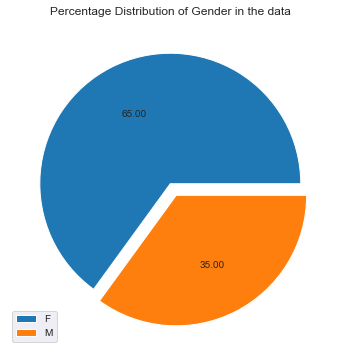

In [37]:
# Percentage Distribution of Gender in the data.
plt.figure(figsize=(12,6))
plt.pie(x=data.Gender.value_counts(),autopct='%.2f',explode=[0,0.1])
plt.title('Percentage Distribution of Gender in the data')
plt.legend(data.Gender.unique());

In [42]:
# Plotting histogram to visualize the distribution based on show up status.
fig=px.histogram(data,x='Gender',title='Gender distribution',color='No-show',barmode='group',marginal='box')
fig.show()

In [43]:
# Plotting histogram to visualize the percetage distribution of gender based on the show up column.
fig=px.histogram(data,x='Gender',title='Percentage of Gender distribution',color='No-show',barmode='group',barnorm='percent')
fig.show()

### Insights from the Gender column
- In the gender distribution, we have more females than males. Females are 65% wile men are 35% of the total population in the dataset. This may indicate that female are either more concerned about their health than men, or due to some health conditions like pregnancy they had more appointments than men.
- From the histogram above, we have 57,246 (79.7%) female who showed up for the appointment yet 14,594 (20.3%) female did not show up.
- Again it is evident that 30,962 (80%) males showed up for the appointment while 7,725 (20%) did not show up.
- Therefore although we have more females than males showing up for the appointments, the trend for showing up seems the same between female and male that is about 80% will show up, but about 20% doesn't show up across the gender.

### Research Question 2: Did the timing of the appointment affect the show up?

In [46]:
# What years did the scheduling take place?
data.SchYear.value_counts(normalize=True)*100

2016    99.943905
2015     0.056095
Name: SchYear, dtype: float64

In [47]:
# What years were the appointments were done? 
data.AppYear.value_counts()

2016    110465
2015        62
Name: AppYear, dtype: int64

In [58]:
# Duration (Months) covered in the entire dataset from 2015 to 2016 
data.groupby('AppYear').AppMonth.value_counts()

AppYear  AppMonth
2015     12             61
         11              1
2016     5           67421
         4           25339
         6           13750
         3            3614
         2             281
         1              60
Name: AppMonth, dtype: int64

In [59]:
# Plotting the scheduled year to see which months had highest scheduled appointments
fig=px.histogram(data,x='SchYear',color='SchMonth',barmode='group',title='Distribution sheduled months for both 2016 and 2015')
fig.show()

In [60]:
# Plotting the scheduled year to see which months had highest scheduled appointments
fig=px.histogram(data,x='SchMonth',color='SchWeekday',barmode='group',title='Distribution of Scheduled days monthwise')
fig.show()

In [61]:
# Plotting the appointment year to see which days had highest appointments
fig=px.histogram(data,x='AppYear',color='AppMonth',barmode='group',title='Distribution of appointment months for both 2016 and 2015')
fig.show()

In [62]:
# Plotting the appointment year to see which days had highest scheduled appointments
fig=px.histogram(data,x='AppMonth',color='AppWeekday',barmode='group',title='Distribution of appointment days monthwise')
fig.show()

In [63]:

fig=px.histogram(data,x='AppHour',color='No-show',barmode='group',
                title='Distribution of appointment hours')
fig.show()

### Insights from Time columns
+ The data shows that we have two categories of years, 2015 and 2016. 2016 with 110,465 appointments takes 99.9% of the entire dataset while the remaining 0.1% (62)is for 2015. We have 8 months in which the data is built upon (From Nov 2015 to June 2016 ) 
+ From the plot on months per year (ScheduledYear), we see that in Dec there was very few scheduled appointments which increased gradually from that Dec to May then there in June the the number is low, perhaeps because the whole month was not considered. This is the same with the AppointmentYear.
+ Considering the days, there seems to be no trend on the days that received highest number of appointments.
+ It appears that the Sceduled Day was the same as the Appoinment Day.
+ It can be seen that appointment hours that had highest show up were between 7 to 11 AM, and then from 1 pm to 4 PM. 

### Research Question 3: What age showed up for the appointment?

In [64]:
data.Age.value_counts().head()

0     3540
1     2273
52    1746
49    1652
53    1651
Name: Age, dtype: int64

In [65]:
# Visualizing the Age distribution in the dataset
fig=px.histogram(data,x='Age',title='Distribution of age.',color='Gender',marginal='box')
fig.show()

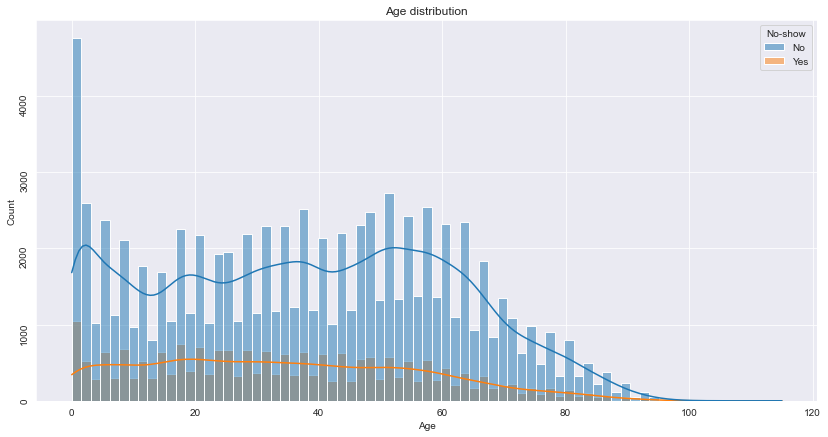

In [66]:
# Visualizing the Age distribution in the dataset
plt.figure(figsize=(14,7))
sns.histplot(x=data['Age'],hue=data['No-show'],kde=True)
plt.title('Age distribution')
plt.yticks(rotation=90);


### Insights from age
+ It appears that many appointments were scheduled for the age 0-1. This could be because of children have progams such as vaccinations that require them to visit regularly. 
+ Again, the age at about 50 there seems to be more people with appointments and especially Female gender as show earlier, perharps because as people age, they are prone to diseases due to many factors such as hormonal changes and many more. We may need to investigate the diseases given to see how they relate especially with age.
+ From the box plot at the margin above, we see that the median age for Female is 39 while that for male is 33, the least is 0 with the highest age for male as 100 while that of female is 115. The majority have their ages below 54 for male while for female are below 56.
+ Generally, those who did not show up are fewer than those who showed up in each age.

### Research Question 4: Did neigbourhood affect showing up for the appointment?

In [67]:
# Getting the number of unique values in the neigbourhood colun
data.Neighbourhood.nunique()

81

In [68]:
#Getting the counts of people per location
data.Neighbourhood.value_counts()

JARDIM CAMBURI                 7717
MARIA ORTIZ                    5805
RESISTÊNCIA                    4431
JARDIM DA PENHA                3877
ITARARÉ                        3514
                               ... 
ILHA DO BOI                      35
ILHA DO FRADE                    10
AEROPORTO                         8
ILHAS OCEÂNICAS DE TRINDADE       2
PARQUE INDUSTRIAL                 1
Name: Neighbourhood, Length: 81, dtype: int64

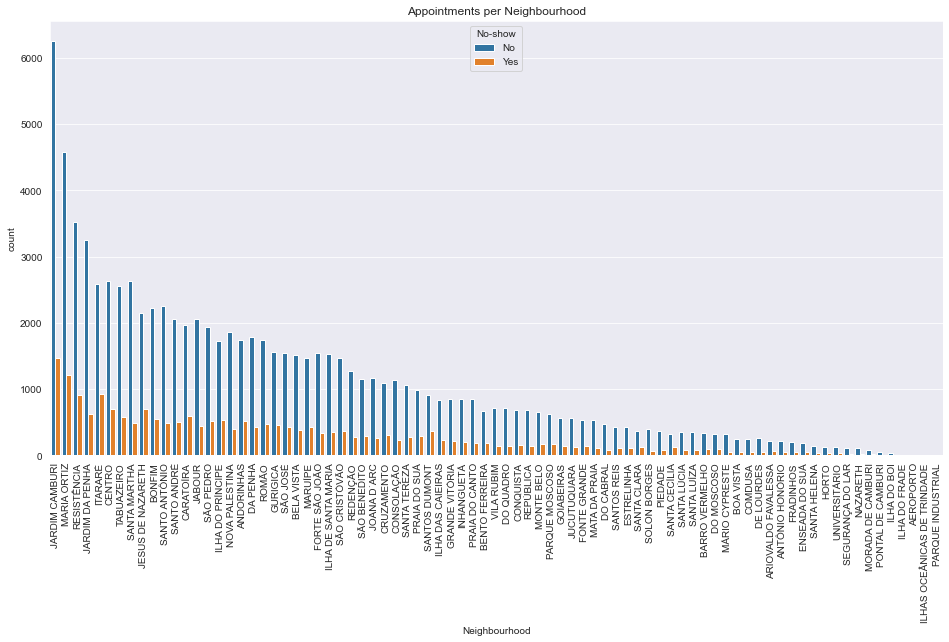

In [73]:
plt.figure(figsize=(16,8))
sns.countplot(data=data,x='Neighbourhood',hue='No-show',order=data.Neighbourhood.value_counts().index)
plt.xticks(rotation=90)
plt.title('Appointments per Neighbourhood');

### Insights from the Neighbourhood column
+ It appears that there are 81 medical facility centers. 
+ Jardim Carburi is the highest number of appointments (7717) while the least is Parque Industrial which has only 1 appointment.
+ It may be well to investigate the locations for these centers to see if they are in a rural or urban centers to see if the appointments are influenced by population.


### Research Question 5: Did scholarship affect show up

In [75]:
# To check the distribution of scholarship
data.Scholarship.value_counts()/len(data)*100
# Assuming 0 means no schorlarship and 1 means has scholarship.

0    90.173442
1     9.826558
Name: Scholarship, dtype: float64

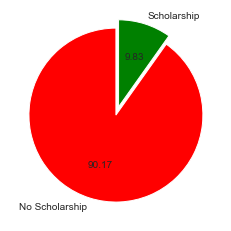

In [84]:
label= ['No Scholarship','Scholarship']
plt.pie(data.Scholarship.value_counts(normalize=True),autopct='%.2f',colors=['red','green'],
        labels=label,explode=[0,0.1],startangle=90);


In [85]:
# Plotting histogram to show the distribution in comparison to gender
fig=px.histogram(data,x='Scholarship',color='Gender',barmode='group',title=
                 'Percentage distribution of Scholarship Gender-wise',barnorm='percent')
fig.show()

In [86]:
# Plotting histogram to show Scholarship distribution according to show up.
fig=px.histogram(data,x='Scholarship',color='No-show',barmode='group',title=
                 'Percentage distribution of Scholarship',barnorm='percent')
fig.show()

### Insights from the Scholarship column
+ Only 9.8% of those with appointments have a scholarship from Bolsa Familia. The rest (90.2%) do not have.
+ It is clear that out of the 9.8% people with scholarship, female have more scholarships as compared to men.  
+ From the histogram above, 23.7% of those who had scholarship did not show up for the appointment, while the remaining 76.3% of those with scholarship showed up.
+ 19.8% of those without scolarship did not show up, while 80.2% of those without showed up. This tells that those with scholarship did not take the appointments serious. Further investigation especially on diseases and sms received may help us understand this better.


### Research Question 6: What disease is associated with high number of show ups
#### a) `Hypertension`

In [87]:
data.Hypertension.value_counts()/len(data)*100

0    80.275408
1    19.724592
Name: Hypertension, dtype: float64

In [88]:
# Plotting histogram for hypertension
fig=px.histogram(data,x='Hypertension',color='Gender',barmode='group',title=
                 'Percentage distribution of people with Hypertension',barnorm='percent')
fig.show()

In [89]:
# Plotting histogram to show hypertenion distribution
fig=px.histogram(data,x='Hypertension',color='No-show',barmode='group',title=
                 'Percentage distribution of people with Hypertension',barnorm='percent')
fig.show()

### Insights from hypertension column
+ Only 20% of the population is suffering from hypertension. 
+ From the plot, it appears that female are more hypertensive as compared to male. They showed up more for the appointments.
+ 82% of those with hypertension showed up for the appointment while 79% of those without hypertension showed up. This means suffering from hypertension can increase the show up for the appointment.


#### b) `Diabetes`

In [90]:
data.Diabetes.value_counts()/len(data)*100

0    92.813521
1     7.186479
Name: Diabetes, dtype: float64

In [92]:
# Plotting histogram to show Diabetes distribution gender-wise
fig=px.histogram(data,x='Diabetes',color='Gender',barmode='group',title=
                 'Percentage distribution of people with Diabetes',barnorm='percent')
fig.show()

In [93]:
# Plotting histogram to show Diabetes distribution based on scholarship status
fig=px.histogram(data,x='Diabetes',color='Scholarship',barmode='group',title=
                 'Percentage distribution of people with Diabetes',barnorm='percent')
fig.show()

In [94]:
# Plotting histogram to show Diabetes distribution
fig=px.histogram(data,x='Diabetes',color='No-show',barmode='group',title=
                 'Percentage distribution of Diabetes',barnorm='percent')
fig.show()

### Insights from Diabetes Column
+ It appears that many people in the dataset (92.3%) are non-diabetic while 7.2% are diabetic.
+ 70.6% of the diabetics is made up of female, while 64.6% of the non-diabetics are female. This tells that we have more females with diabetes in the dataset. This is another reason as to why they show up for the appointments more than men.
+ From the plots, 92% diabetics are without scholarship while 89.9% of those without diabetes have no scholarship.  
+ It seems like those with diabetes showed up for the appointment more than those without. 


### Research Question 7: Does alcoholism affect the way people show up for the medical appoitments?

In [95]:
# Counting the number of people per class (alcoholic or non-alcoholic)
data.Alcoholism.value_counts()

0    107167
1      3360
Name: Alcoholism, dtype: int64

In [97]:
# Plotting histogram to show Alcoholism distribution
fig=px.histogram(data,x='Alcoholism',color='Scholarship',barmode='group',title=
                 'Percentage distribution of Alcoholism',barnorm='percent')
fig.show()

In [101]:
# Plotting histogram to show Alcoholism distribution
fig=px.histogram(data,x='Alcoholism',color='No-show',barmode='group',title=
                 'Percentage distribution of Alcoholism',barnorm='percent')
fig.show()

In [99]:
# Plotting histogram to show Alcoholism distribution
fig=px.histogram(data,x='Alcoholism',color='Gender',barmode='group',title=
                 'Percentage distribution of Alcoholism',barnorm='percent')
fig.show()

### Insights from the Alcohol column
+ 84% of the alcoholic group have no scolarships, while 16% have scholarship. The number of alcoholic with scholarship is higher than that which is non-alcoholic. May be because they are in the poor class that is funded by the Bolsa Familia. 
+ It seems that alcoholism does not affect show up. In both cases, alcoholism and non-alcoholism, the percentage of show up is almost the same.
+ 63.6% of the drunkards are men, while 65.9% of the non-drunkards are female. 

### Research Question 8: Does receiving sms impact the likelihood of show up? 

In [102]:
data.SMS_received.value_counts()/len(data)*100

0    67.897437
1    32.102563
Name: SMS_received, dtype: float64

In [103]:
# Plotting histogram to show SMS received distribution
fig=px.histogram(data,x='SMS_received',color='No-show',barmode='group',title=
                 'Percentage distribution of SMS received',barnorm='percent')
fig.show()

### Insights from the SMS_received column
+ 67.9% of the population did not receive txt message.
+ 83% of those who did not receive the sms showed up, while 72% of those who received showed up. This tells us that sms has no weight in increasing the show up for the appointment.

<a id='conclusions'></a>
## Conclusions
> Although we have more females than males showing up for the appointments, the trend for showing up seems the same between female and male that is about 80% did show up, but about 20% didn't show up across the gender.

> It appears that many appointments were scheduled for the age 0-1. This could be because of children have progams such as vaccinations that require them to visit regularly.  Again, the age at about 50 there seems to be more people with appointments and especially Female gender, perharps because as people age, they are prone to diseases due to many factors such as hormonal changes and many more. 

> We have also realized that we have more female with lifestyle diseases like diabetes and hypertension as compared to men and that those who suffer from lifestyle diseases like pressure and diabetes are more likely to show up for the appointment

> It has been noted that we have more men who take alcohol, as compared to female. Those who take alcohol have more scholarships perharps because they are prone to poverty issues that Bolsa Familia addresses.

> It has also been noted that features such as scholarship and sms received did not contribute significantly to the show up column. 
